### Load Modules

In [2]:
import layoutparser as lp
from PIL import Image
import numpy as np

### Load Model
We can also specify model weights path in case we want to use the custom taxonomy model. In that case we would also need to change the <u>label_map</u>. 

In [3]:
model = lp.Detectron2LayoutModel(
            config_path ='lp://PrimaLayout/mask_rcnn_R_50_FPN_3x/config', # In model catalog
            label_map   ={1:"TextRegion", 2:"ImageRegion", 3:"TableRegion", 4:"MathsRegion", 5:"SeparatorRegion", 6:"OtherRegion"}, # In model`label_map`
            extra_config=["MODEL.ROI_HEADS.SCORE_THRESH_TEST", 0.8] # Optional
        )

The checkpoint state_dict contains keys that are not used by the model:
  pixel_mean
  pixel_std
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


### Load an Image
We can make this process recursive

In [77]:
im = Image.open('../test_set/00000273.tif')

### Detection&Visualization
Once you detect an imahe, there are multiple options when visualizing it. We can go to LayoutParser's documentation for clarity of how to exploit them.

In [78]:
layout = model.detect(im)

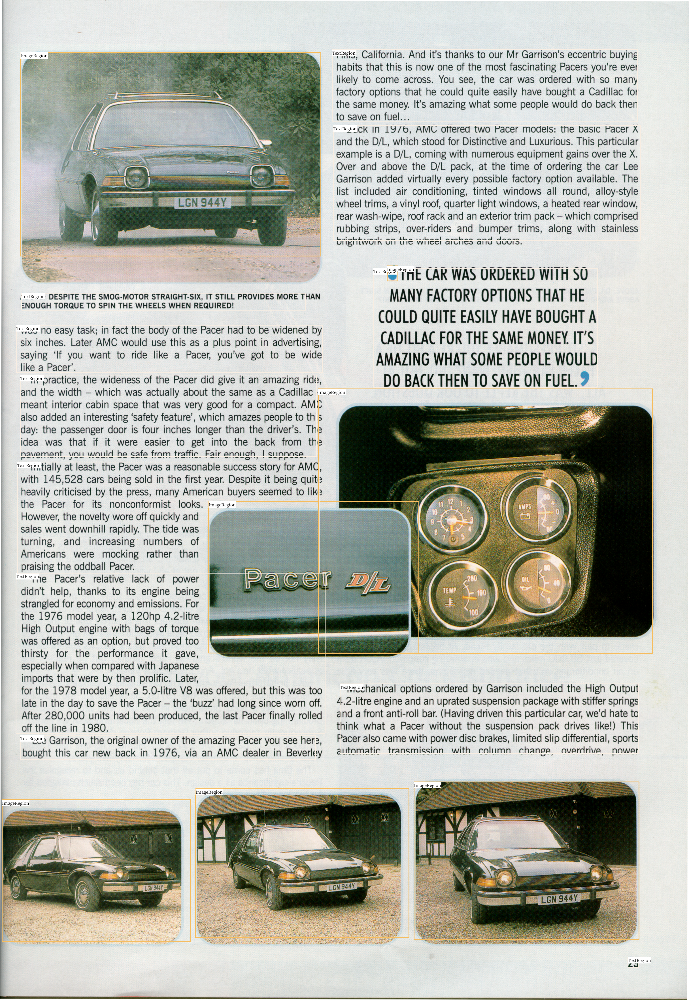

In [51]:
lp.draw_box(im, layout, box_width=3, show_element_type=True)

### Text Manipulation

In [79]:
text_blocks = lp.Layout([b for b in layout if b.type=='TextRegion'])
figure_blocks = lp.Layout([b for b in layout if b.type=='ImageRegion'])

In [80]:
text_blocks = lp.Layout([b for b in text_blocks if not any(b.is_in(b_fig) for b_fig in figure_blocks)])

### Ordering $0^{th}$ Type

In [81]:
arr_im = np.asarray(im)

height, width = arr_im.shape[:2]

In [82]:
text_blocks.sort(key = lambda b:b.coordinates[0], inplace=True)

intervals = []

for i in range(len(text_blocks)):
    x_1 = text_blocks[i].block.x_1
    if i == 0:
        intervals.append(x_1)
        curr_x = x_1
    else:
        if (x_1 - curr_x) >= 500:
            intervals.append(x_1)
            curr_x = x_1  

In [83]:
blocks = []

for i in range(len(intervals)):
    if i == len(intervals) - 1:
        curr_interval = lp.Interval(intervals[i],width, axis='x').put_on_canvas(im)
    else:
        curr_interval = lp.Interval(intervals[i], intervals[i+1], axis='x').put_on_canvas(im)
    block = text_blocks.filter_by(curr_interval, center=True)
    block.sort(key = lambda b:b.coordinates[1], inplace=True)
    blocks.append(block)

    

In [84]:
bl = blocks[0]
for i in range(1,len(blocks)):
    bl += blocks[i]

text_blocks = lp.Layout([b.set(id = idx) for idx, b in enumerate(bl)])

### Ordering $1^{st}$ Type
We split the image in three intervals with regards to the x-axis. Then recursively we order the text boxes up-down, left-right. If the box's center isn't in the interval, it is skipped. In each interval we order the boxes by the value of **$y_1$**

In [141]:
h, w = arr_im.shape[:2]

left_interval = lp.Interval(0, w/3, axis='x').put_on_canvas(im)
left_blocks = text_blocks.filter_by(left_interval, center=True)
left_blocks.sort(key = lambda b:b.coordinates[1], inplace=True)

central_interval = lp.Interval(w/3, w*2/3, axis='x').put_on_canvas(im)
all_central_block = lp.Layout([b for b in text_blocks if b not in left_blocks])
central_blocks = all_central_block.filter_by(central_interval, center=True)
central_blocks.sort(key = lambda b:b.coordinates[1], inplace=True)

right_blocks = lp.Layout([b for b in all_central_block if b not in central_blocks])
right_blocks.sort(key = lambda b:b.coordinates[1], inplace=True)
text_blocks = lp.Layout([b.set(id = idx) for idx, b in enumerate(left_blocks + central_blocks + right_blocks)])

### Ordering $2^{nd}$ Type

In [59]:
h, w = arr_im.shape[:2]

left_interval = lp.Interval(0, w/2*1.05, axis='x').put_on_canvas(im)

left_blocks = text_blocks.filter_by(left_interval, center=True)
left_blocks.sort(key = lambda b:b.coordinates[1], inplace=True)
# The b.coordinates[1] corresponds to the y coordinate of the region
# sort based on that can simulate the top-to-bottom reading order 
right_blocks = lp.Layout([b for b in text_blocks if b not in left_blocks])
right_blocks.sort(key = lambda b:b.coordinates[1], inplace=True)

# And finally combine the two lists and add the index
text_blocks = lp.Layout([b.set(id = idx) for idx, b in enumerate(left_blocks + right_blocks)])

/home/georgi006/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


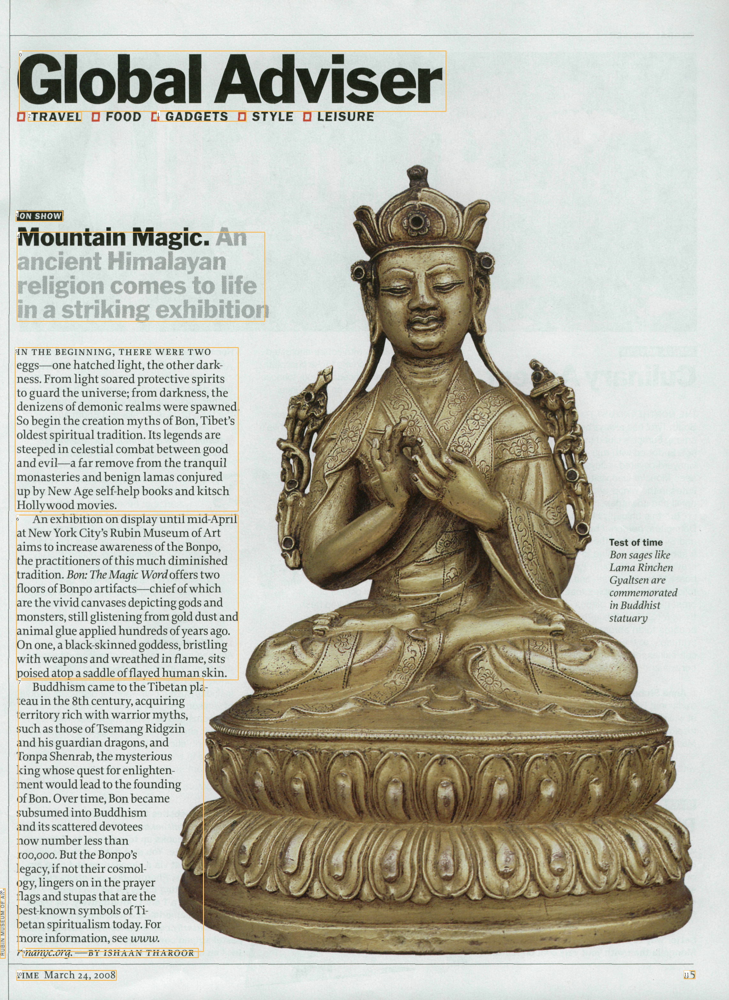

In [85]:
lp.draw_box(im, text_blocks,
            box_width=3, 
            show_element_id=True)

### Text Extraction

In [107]:
ocr_agent = lp.TesseractAgent(languages='eng') 

In [108]:
for block in text_blocks:
    segment_image = (block.pad(left=10, right=10, top=10, bottom=10).crop_image(arr_im))
        # add padding in each image segment can help
        # improve robustness 
        
    text = ocr_agent.detect(segment_image)
    block.set(text=text, inplace=True)

In [16]:
for txt in text_blocks.get_texts():
    print(txt, end='\n---\n')

ABOVE: DESPITE THE SMOG-MOTOR STRAIGHT-SIX, IT STILL PROVIDES MORE TI
ENOUGH TORQUE TO SPIN THE WHEELS WHEN REQUIRED!

---
was no easy task; in fact the body of the Pacer had to be widened by
six inches. Later AMC would use this as a plus point in advertising,
saying ‘If you want to ride like a Pacer, you’ve got to be wide
like a Pacer’.

---
In practice, the wideness of the Pacer did give it an amazing ride
and the width — which was actually about the same as a Cadillac -
meant interior cabin space that was very good for a compact. AM(
also added an interesting ‘safety feature’, which amazes people to thi:
day: the passenger door is four inches longer than the driver’s. Th
idea was that if it were easier to get into the back from th
pavement, you would be safe from traffic. Fair enough, | suppose.

---
Initially at least, the Pacer was a reasonable success story for AMC,
with 145,528 cars being sold in the first year. Despite it being quite
heavily criticised by the press, many Ame

/home/georgi006/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
